# Read before runing

%### function of this script:
% 1. define the path for training input and output data% 2. 读取raw data，标准化这个training data并保存到training_data文件夹中,这样的话calibration脚本就可以直接使用


% NOTE：tdab是TAS，其余试验都是相对于PI的TAS anomaly， PI是tdab[1]

% modice: 
% tdum(40):dTeq_temp_mm_1_5m_ann_tdum.nc
% tdvo(20):dTeq_temp_mm_1_5m_ann_tdvo_LT2000ppm.nc

% highice:
% tdab28(26):dT500_temp_mm_1_5m_ann_tdab28k.nc
% tdab80(26):dT500_temp_mm_1_5m_ann_tdab80k.nc
% tdab120(10):dT500_temp_mm_1_5m_ann_tdab120k.nc

% lowice: 
% tdvp(40):dTeq_temp_mm_1_5m_ann_tdvp.nc
% tdvq(20):dTeq_temp_mm_1_5m_ann_tdvq_LT2000ppm.nc


% 根据以下脚本，似乎对于lowice的定义有些不同？有两个emulator，一个是“过去模拟”，脚本叫做“modice";一个是“未来模拟”，脚本叫做“modlowice".
% modice：dTeq_dT500_temp_ann_modice_LT2000ppm_tdab_cjrw.R # modice+ highice: tdum, tdvo and tdab
% modlowice：dTeq_dT500_temp_ann_modlowice_LT2000ppm_cjrw.R # modice+lowice: tdum, tdvo, tdvp and tdvq

In [1]:
### load packages needed
import numpy as np
import pandas as pd
import netCDF4 as nc

# here's where we storage the standardlized datab

In [2]:
training_data_path="training_data/"

# here's where we read the raw data from

## raw data path

In [3]:
input_folder="/Users/bo20541/Library/CloudStorage/OneDrive-UniversityofBristol/TONIC-Oligocene/Emulator_Charlie/Emulator/2015_Bristol_5D_v001/orig/Input/"
input_path1=input_folder+"Samp_orbits_tdum.res"
input_path2=input_folder+"Samp_orbits_tdvo_LT2000ppm.res"
input_path3=input_folder+"Samp_orbits_tdvp.res"
input_path4=input_folder+"Samp_orbits_tdvq_LT2000ppm.res"

# input_path5=input_folder+"Samp_orbits_tdum.res"
# input_path6=input_folder+"Samp_orbits_tdvo_LT2000ppm.res"
# input_path7=input_folder+"Singarayer + Valdes 2010/Samp_orbits_tdab.res"

output_folder="/Users/bo20541/Library/CloudStorage/OneDrive-UniversityofBristol/TONIC-Oligocene/Emulator_Charlie/Emulator/2015_Bristol_5D_v001/orig/Output/dTeq/LT2000/"
output_path1=output_folder+"dTeq_precip_mm_srf_ann_tdum.nc"
output_path2=output_folder+"dTeq_precip_mm_srf_ann_tdvo_LT2000ppm.nc"
output_path3=output_folder+"dTeq_precip_mm_srf_ann_tdvp.nc"
output_path4=output_folder+"dTeq_precip_mm_srf_ann_tdvq_LT2000ppm.nc"
# output_path5=output_folder+"dTeq_temp_mm_1_5m_ann_tdum.nc"
# output_path6=output_folder+"dTeq_temp_mm_1_5m_ann_tdvo_LT2000ppm.nc"
# output_path7=output_folder+"../../Singarayer + Valdes 2010/dT500_temp_mm_1_5m_ann_tdab28k.nc"
# output_path8=output_folder+"../../Singarayer + Valdes 2010/dT500_temp_mm_1_5m_ann_tdab80k.nc"
# output_path9=output_folder+"../../Singarayer + Valdes 2010/dT500_temp_mm_1_5m_ann_tdab120k.nc"


# generate the var name list for each output expID
output_expID = ["tdum", "tdvo", "tdvp", "tdvq"]
output_list1 = [output_expID[0] + char for char in ["a", "b", "c", "d", "e", "f", "g", "h", "i", "j", "k", "l", "m", "n", "o", "p", "q", "r", "s", "t", "u", "v", "w", "x", "y", "z", "A", "B", "C", "D", "E", "F", "G", "H", "I", "J", "K", "L", "M", "N"]]
output_list2 = [output_expID[1] + char for char in ["c", "d", "g", "h", "i", "k", "n", "o", "p", "q", "s", "u", "v", "w", "y", "C", "D", "E", "H", "M"]]
output_list3 = [output_expID[2] + char for char in ["a", "b", "c", "d", "e", "f", "g", "h", "i", "j", "k", "l", "m", "n", "o", "p", "q", "r", "s", "t", "u", "v", "w", "x", "y", "z", "A", "B", "C", "D", "E", "F", "G", "H", "I", "J", "K", "L", "M", "N"]]
output_list4 = [output_expID[3] + char for char in ["c", "d", "g", "h", "i", "k", "n", "o", "p", "q", "s", "u", "v", "w", "y", "C", "D", "E", "H", "M"]]


input_paths = [input_path1, input_path2, input_path3, input_path4]
output_paths = [output_path1, output_path2, output_path3, output_path4]
output_lists = [output_list1, output_list2, output_list3, output_list4]


training_data_dict = {}
training_data_dict['expID'] = output_expID
training_data_dict['input_path'] = input_paths
training_data_dict['output_path'] = output_paths
training_data_dict['output_list'] = output_lists

nlat = 73
nlon = 96
print(training_data_dict.keys())
print("example of the first simulation:")
for key in training_data_dict.keys():
	print(key, training_data_dict[key][0])


dict_keys(['expID', 'input_path', 'output_path', 'output_list'])
example of the first simulation:
expID tdum
input_path /Users/bo20541/Library/CloudStorage/OneDrive-UniversityofBristol/TONIC-Oligocene/Emulator_Charlie/Emulator/2015_Bristol_5D_v001/orig/Input/Samp_orbits_tdum.res
output_path /Users/bo20541/Library/CloudStorage/OneDrive-UniversityofBristol/TONIC-Oligocene/Emulator_Charlie/Emulator/2015_Bristol_5D_v001/orig/Output/dTeq/LT2000/dTeq_precip_mm_srf_ann_tdum.nc
output_list ['tduma', 'tdumb', 'tdumc', 'tdumd', 'tdume', 'tdumf', 'tdumg', 'tdumh', 'tdumi', 'tdumj', 'tdumk', 'tduml', 'tdumm', 'tdumn', 'tdumo', 'tdump', 'tdumq', 'tdumr', 'tdums', 'tdumt', 'tdumu', 'tdumv', 'tdumw', 'tdumx', 'tdumy', 'tdumz', 'tdumA', 'tdumB', 'tdumC', 'tdumD', 'tdumE', 'tdumF', 'tdumG', 'tdumH', 'tdumI', 'tdumJ', 'tdumK', 'tdumL', 'tdumM', 'tdumN']


## Read raw training data

In [4]:
input_data = pd.DataFrame(columns=['co2','obliquity','esinw','ecosw','ice'])
output_data = np.empty((0, nlat, nlon))

for i in range(len(output_expID)):
    # load input data
    emu_input_data = pd.read_csv(training_data_dict['input_path'][i], sep='\s+', header=0)
    input_data = pd.concat([input_data, emu_input_data[['co2', 'obliquity', 'esinw', 'ecosw', 'ice']]], ignore_index=True)
    # load output data
    emu_output_data = nc.Dataset(training_data_dict['output_path'][i], mode='r')
    for var in training_data_dict['output_list'][i]:
        var_redD = np.squeeze(emu_output_data[var][:])
        if output_expID[i] == 'tdab':
            var_redD = var_redD * 60.0*60.0*24.0*30.0 # convert to mm/day
        else:
            var_redD = var_redD * 30.0 # convert to mm/month
        output_data = np.concatenate([output_data, np.expand_dims(var_redD, axis=0)], axis=0)

    latitude = emu_output_data.variables['latitude'][:]
    longitude = emu_output_data.variables['longitude'][:]

print("shape of emulator input data (5 variables):",input_data.shape)
print("header of the input data:",input_data.head())
print("shape of emulator output data (ESM outputs):",output_data.shape)


/var/folders/vs/yssw4zdd30s_f2rzqz5v0g880000gr/T/ipykernel_25593/1904034558.py:7: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  input_data = pd.concat([input_data, emu_input_data[['co2', 'obliquity', 'esinw', 'ecosw', 'ice']]], ignore_index=True)


shape of emulator input data (5 variables): (120, 5)
header of the input data:       co2  obliquity    esinw    ecosw  ice
0  375.73      22.99 -0.03090  0.03689  0.0
1  516.89      23.02  0.02898  0.01432  0.0
2  470.40      22.81 -0.02098  0.04331  0.0
3  390.30      24.03  0.05347  0.00481  0.0
4  325.35      23.09 -0.02685  0.01185  0.0
shape of emulator output data (ESM outputs): (120, 73, 96)


## *optional： visulazing the training data

/var/folders/vs/yssw4zdd30s_f2rzqz5v0g880000gr/T/ipykernel_25593/125530049.py:25: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed in 3.10.
  return contour.collections
/var/folders/vs/yssw4zdd30s_f2rzqz5v0g880000gr/T/ipykernel_25593/125530049.py:40: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed in 3.10.
  return contour.collections
Animation size has reached 21079596 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


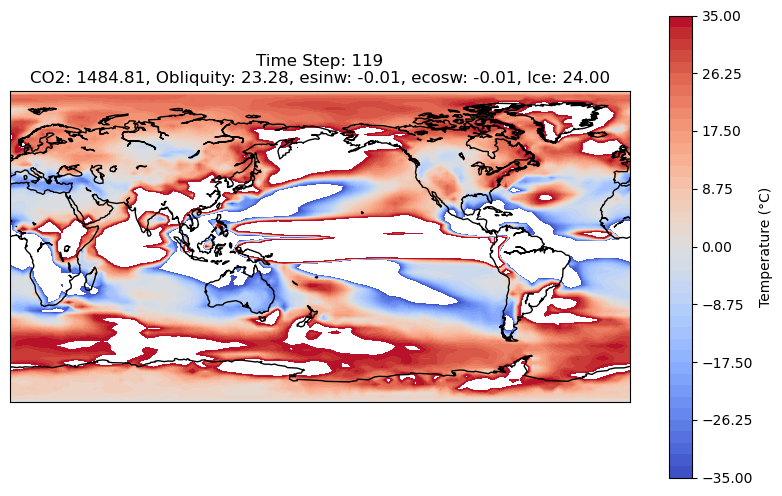

In [5]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from mpl_toolkits.basemap import Basemap

# 创建 figure 和轴对象
fig, ax = plt.subplots(figsize=(10, 6))

# 经纬度网格
lat = np.linspace(-90, 90, 73)
lon = np.linspace(0,360, 96)
X, Y = np.meshgrid(lon, lat)
# 创建 Basemap（用于绘制海陆分界线）
m = Basemap(projection='cyl', lon_0=180, resolution='c', ax=ax)
m.drawcoastlines()

# 初始绘图
contour = ax.contourf(X, Y, np.flipud(output_data[0]), cmap='coolwarm', levels=np.linspace(-35, 35, 41))
cbar = plt.colorbar(contour, ax=ax, orientation='vertical')
cbar.set_label('Temperature (°C)')

# 初始化函数
def init():
    ax.set_title('Time Step: 0')
    return contour.collections

# 更新函数
def update(frame):
    ax.clear()
    m.drawcoastlines()
  
    # 更新等高线图
    contour = ax.contourf(X, Y, np.flipud(output_data[frame]), cmap='coolwarm', levels=np.linspace(-35, 35, 41))
    ax.set_title(f'Time Step: {frame}\n'
                 f'CO2: {input_data.iloc[frame, 0]:.2f}, '
                 f'Obliquity: {input_data.iloc[frame, 1]:.2f}, '
                 f'esinw: {input_data.iloc[frame, 2]:.2f}, '
                 f'ecosw: {input_data.iloc[frame, 3]:.2f}, '
                 f'Ice: {input_data.iloc[frame, 4]:.2f}')
    return contour.collections

# 创建动画
ani = FuncAnimation(fig, update, frames=range(120), init_func=init, blit=False)

# 在 Jupyter Notebook 中显示动画
HTML(ani.to_jshtml())



# write the data

In [6]:
# Save input data as .res file
input_data.to_csv(training_data_path + 'emul_in_X.res', sep='\t', index=False)

# Save output data as .nc file
with nc.Dataset(training_data_path + 'emul_in_Y.nc', 'w', format='NETCDF4') as ds:
    ds.createDimension('n', output_data.shape[0])
    ds.createDimension('latitude', output_data.shape[1])
    ds.createDimension('longitude', output_data.shape[2])
    
    latitudes = ds.createVariable('latitude', 'f4', ('latitude',))
    longitudes = ds.createVariable('longitude', 'f4', ('longitude',))
    var = ds.createVariable('var', 'f4', ('n', 'latitude', 'longitude',))
    
    latitudes[:] = latitude
    longitudes[:] = longitude
    var[:,:,:] = output_data
    
    ds.description = 'Training data used to calibrate emulator, it is the output data (ESM output) of each input data (5 variables)'
    latitudes.units = 'degrees_north'
    longitudes.units = 'degrees_east'
    